# Spatial Data Science Bootcamp Madrid - May 2023

## Leveraging Python for Spatial Data Science

### Territory optimization

Efficient allocation of resources is crucial for maximizing profitability and customer satisfaction. **Territory optimization** plays a vital role in achieving these objectives by strategically organizing and managing geographic areas to ensure effective coverage and distribution. It applies to different industries and use cases (see list below) and can be run with different data sources (see list below).

#### Industries

Territory optimization is key in many different industries such as:
- On-demand courier service
- Ride sharing and micromobility
- Logistics and trandportation
- Field management
- Real Estate
- Urban planning

#### Use cases

Territory optimization can cover different use cases:
- Sales territory management
- Technician territory planning
- Supply Chain Network Optimization
- Electric vechicle charging station allocation
- Asset management

#### Data sources

Territory optimization can be performed using different data sources:
- Historical orders
- Customer locations
- Locations of events (pick up - drop off events, accidents, photos, app usage, weather events, etc.)
- Asset locations
- Resource locations (hubs, distribution centers, sales reps, bike stations, etc.)
- Administrative territories


<img src="images/workshop_image.png" width="1000">


### **Workshop purpose: Territory optimization with Python**

In this workshop, we will cover an end-to-end analysis for territory optimization using Python. **You will learn**:
- **Point pattern analysis**: Discover the power of point pattern analysis and how it can provide valuable insights into the spatial distribution of your business data. Learn how to identify clustering patterns, hotspots, and spatial relationships within your territories.
- **Undersdtanding spatial drivers for your business performance**. Through Geographically Weighted Regression (GWR), explore how to analyze the varying impacts of geographic factors on your sales, customer concentration, or market potential,
- **Territory Creation Techniques**: Explore a range of techniques to create optimized territories tailored to your specific business needs.

For this, we will use some of the spatial libraries available for Python, namely:
- [Shapely](https://shapely.readthedocs.io/en/latest/manual.html)
- [Geopandas](https://geopandas.org/en/stable/index.html)
- [Pysal](https://pysal.org/)
- [cartoframes](https://carto.com/developers/cartoframes/)


Let's get started!

## 0. Setup

In [2]:
import contextily
import geopandas as gpd
import matplotlib.pyplot as plt
import networkx as nx
import numpy as np
import pandas as pd
import seaborn as sns

from cartoframes.viz import *
from h3 import h3
from mgwr.gwr import GWR
from ortools.graph.python import min_cost_flow
from pysal.explore import esda
from pysal.lib import weights
from scipy.spatial.distance import cdist
from shapely import wkt
from shapely.geometry import mapping, Polygon
from sklearn.cluster import AgglomerativeClustering, DBSCAN
from sklearn.decomposition import PCA
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import StandardScaler
from splot.esda import moran_scatterplot, lisa_cluster
from splot.libpysal import plot_spatial_weights
from spopt.region.maxp import MaxPHeuristic

pd.set_option('display.max_columns', None)
sns.set_style('whitegrid')

%matplotlib inline

## 1. Data Loading

### 1.1. Locations

This dataset contains event locations. In our case, they represent order delivery locations, but remember they could be data related to any of the industries or use cases mentioned above.

- *Source*: Simulated data
- *Format*: CSV
- *File path*: `data/order_history.csv`

In [3]:
orders = pd.read_csv('data/order_history.csv')
orders['geometry'] = gpd.points_from_xy(orders['lon'], orders['lat'])
orders = gpd.GeoDataFrame(orders, crs='epsg:4326')
orders.head()

,order_id,lat,lon,geometry
0,0,40.419263,-3.719897,POINT (-3.71990 40.41926)
1,1,40.417093,-3.713083,POINT (-3.71308 40.41709)
2,2,40.416763,-3.716036,POINT (-3.71604 40.41676)
3,3,40.419703,-3.712296,POINT (-3.71230 40.41970)
4,4,40.419013,-3.719572,POINT (-3.71957 40.41901)


In [11]:
orders.shape

(10121, 4)

In [6]:
Map(Layer(orders))

### 1.2. Census data

Spain recently released partial results of the 2021 census. In particular, the released the following indices at the census tract level:

<img src="images/census_variables.png"  width="1000">

- *Source*: [INE](https://www.ine.es/dyngs/INEbase/es/operacion.htm?c=Estadistica_C&cid=1254736176992&menu=resultados&idp=1254735572981#!tabs-1254736195781)
- *Format*: CSV
- *File path*: `data/C2021_Indicadores.csv` & `data/indicadores_desc.csv`

In [4]:
census = pd.read_csv('data/C2021_Indicadores.csv', dtype={'ccaa':str, 'CPRO':str, 'CMUN':str, 'dist':str, 'secc':str})
census.head()

,ccaa,CPRO,CMUN,dist,secc,t1_1,t2_1,t2_2,t3_1,t4_1,t4_2,t4_3,t5_1,t6_1,t7_1,t8_1,t9_1,t10_1,t11_1,t12_1,t13_1,t14_1,t15_1,t16_1
0,01,04,001,01,001,1260,0.4857,0.5143,49.0008,0.1048,0.6008,0.2944,0.0984,0.0984,0.0833,0.0762,0.2163,0.1951,0.3768,0.4681,0.0363,0.2899,0.1507,0.0629
1,01,04,002,01,001,1212,0.4719,0.5281,48.9695,0.0891,0.6287,0.2822,0.0941,0.0899,0.0598,0.0498,0.1812,0.2052,0.3614,0.4547,0.0444,0.2754,0.1739,0.0571
2,01,04,003,01,001,869,0.5086,0.4914,44.5984,0.1208,0.6789,0.2002,0.1231,0.1277,0.0759,0.0628,0.2356,0.1576,0.4686,0.5563,0.0183,0.1728,0.1728,0.0903
3,01,04,003,01,002,1765,0.5008,0.4992,39.7705,0.1773,0.6929,0.1297,0.0793,0.0782,0.0482,0.0386,0.2231,0.1258,0.5455,0.6240,0.0179,0.1219,0.1701,0.0861
4,01,04,003,01,003,2239,0.5092,0.4908,37.5775,0.1894,0.7034,0.1072,0.1215,0.1170,0.0562,0.0435,0.1730,0.1432,0.5802,0.6771,0.0253,0.1047,0.1273,0.0837


In [12]:
census.shape

(2443, 25)

In [170]:
#Census variable description
census_var_df = pd.read_csv('data/indicadores_desc.csv')
pd.set_option('display.max_colwidth', 200)
census_var_df[census_var_df['Tabla'].isin(census.columns)]
#pd.set_option('display.max_colwidth', 40)

,Tabla,Indicador
0,t1_1,Total Personas
1,t2_1,Porcentaje de mujeres
2,t2_2,Porcentaje de hombres
3,t3_1,Edad media
4,t4_1,Porcentaje de personas menores de 16 años
5,t4_2,Porcentaje de personas entre 16 (incluido) y 64 (incluido) años
6,t4_3,Porcentaje de personas con más de 64 años
7,t5_1,Porcentaje extranjeros
8,t6_1,Porcentaje personas nacidas en el extranjero
9,t7_1,Porcentaje personas cursando estudios superiores (escur =08 09 10 11 12 ) sobre población de 16 y más


In [171]:
pd.set_option('display.max_colwidth', 40)

### 1.3. Census section geometries

- *Source*: [INE](https://www.ine.es/dyngs/INEbase/es/operacion.htm?c=Estadistica_C&cid=1254736176992&menu=resultados&idp=1254735572981#!tabs-1254736195781)
- *Format*: GeoJSON
- *File path*: `data/census_tracts_madrid.geojson`

In [8]:
ct = gpd.read_file('data/census_tracts_madrid.geojson', crs='epsg:4326').rename(columns={'CCA':'ccaa', 'CDIS':'dist', 'CSEC':'secc'})
ct.head(2)

,CUSEC,CUMUN,secc,dist,CMUN,CPRO,ccaa,CUDIS,CLAU2,NPRO,NCA,CNUT0,CNUT1,CNUT2,CNUT3,ESTADO,OBS,NMUN,geometry
0,2800101001,28001,001,01,001,28,13,2800101,28001,Madrid,Comunidad de Madrid,ES,3,0,0,I,None,"Acebeda, La","POLYGON ((-3.64316 41.12063, -3.6416..."
1,2800201001,28002,001,01,002,28,13,2800201,28002,Madrid,Comunidad de Madrid,ES,3,0,0,I,None,Ajalvir,"POLYGON ((-3.46946 40.53960, -3.4685..."


We're only interested in Madrid city census tracts.

In [9]:
census = census.merge(ct.loc[ct['NMUN'] == 'Madrid', ['ccaa', 'CPRO', 'CMUN', 'dist', 'secc', 'geometry']],
                      on=['ccaa', 'CPRO', 'CMUN', 'dist', 'secc'])

In [13]:
census.shape

(2443, 25)

In [41]:
# For visualizing the dataset we can optionally transform it into a GeoDataFrame

census = gpd.GeoDataFrame(census, crs='epsg:4326')

In [ ]:
Map(Layer(census, geom_col='geometry'))

### 1.4. Madrid boundary

This dataset can be useful for filtering and visualization purposes.

- *Source*: [Geoportal del Ayuntamiento de Madrid](https://geoportal.madrid.es/IDEAM_WBGEOPORTAL/dataset.iam?id=63dc1627-762b-11e9-861d-ecb1d753f6e8)
- *Format*: shapefile
- *File path*: `data/Termino_Municipal/Termino_municipal.shp`

In [14]:
madrid = gpd.read_file('data/Termino_Municipal/Termino_municipal.shp', crs='epsg:32630')
madrid = madrid.to_crs('epsg:4326')
madrid

,OBJECTID,Shape_Leng,Shape_Area,TM,geometry
0,1,174177.932753,6.044551e+08,Madrid,"POLYGON ((-3.64447 40.63810, -3.6424..."


In [ ]:
Map(Layer(madrid))

## 2. Point Pattern Analysis

When points are seen as events that could take place in several locations but only happen in a few of them, a collection of such events is called a point pattern.

Point pattern analysis is thus concerned with the visualization, description, statistical characterization, and modeling of point patterns, trying to understand the generating process that gives rise and explains the observed data. Common questions in this domain include:
- What does the pattern look like?
- What is the nature of the distribution of points?
- Is there any structure in the way locations are arranged over space? That is, are events clustered? or are they dispersed?
- Why do events occur in those places and not in others?


In [16]:
orders.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 10121 entries, 0 to 10120
Data columns (total 4 columns):
 #   Column    Non-Null Count  Dtype   
---  ------    --------------  -----   
 0   order_id  10121 non-null  int64   
 1   lat       10121 non-null  float64 
 2   lon       10121 non-null  float64 
 3   geometry  10121 non-null  geometry
dtypes: float64(2), geometry(1), int64(1)
memory usage: 316.4 KB


### 2.1. Showing patterns as dots in a scatter plot

We can start by lotting a joint plot combining a lat/lon scatter plot with a histogram. This helps identify where events concentrate.

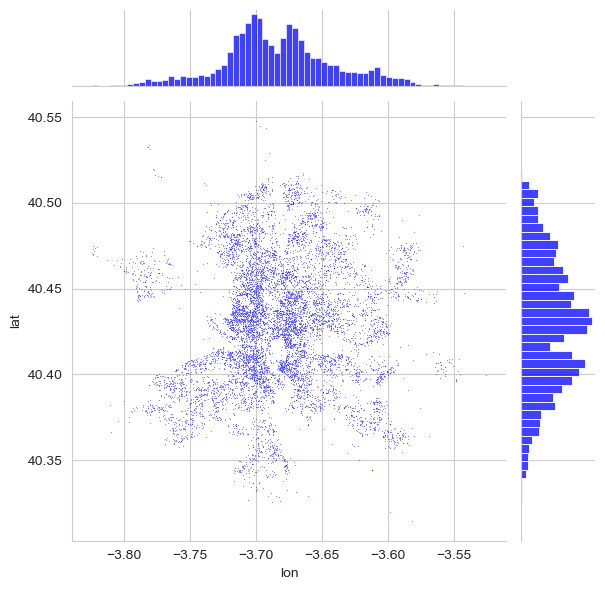

In [17]:
sns.jointplot(x='lon', y='lat', data=orders, s=0.75, color='blue', alpha=0.5)

We can add geographic context by adding a map to the joint plot by using `contextily`.

An interesting pattern we can identify on the latitude histogram is that the bimodal distribution is explained by the presence of large parks/green areas.

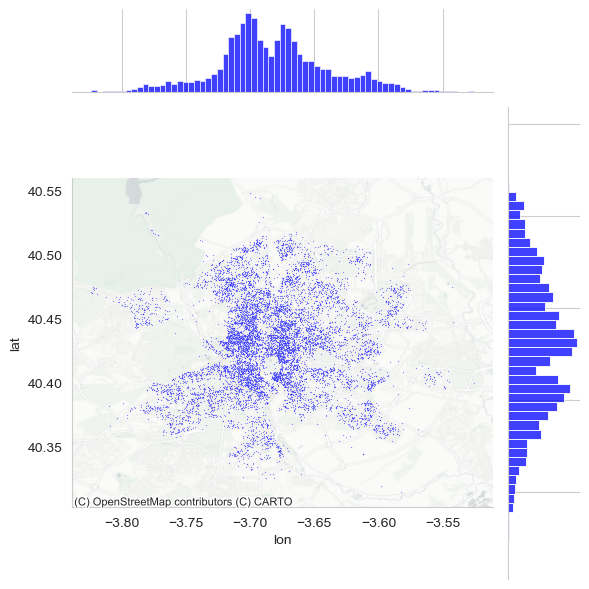

In [18]:
joint_axes = sns.jointplot(x='lon', y='lat', data=orders, s=0.75, color='blue', alpha=0.5)

contextily.add_basemap(
    joint_axes.ax_joint,
    crs="epsg:4326",
    source=contextily.providers.CartoDB.PositronNoLabels
)

plt.grid()
plt.tight_layout()

### 2.2. Kernel density estimation

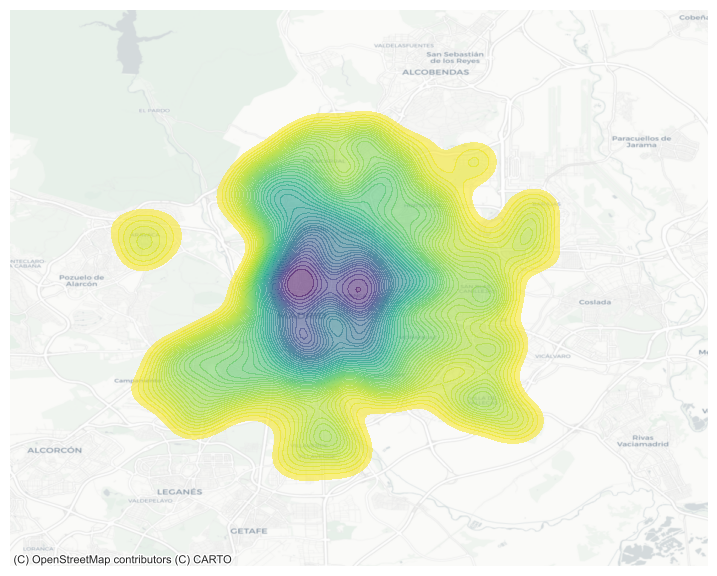

In [19]:
fig, ax = plt.subplots(1, figsize=(9, 9))

# Generate and add KDE with a shading of 50 gradients
# coloured contours, 75% of transparency,
sns.kdeplot(
    x='lon', 
    y='lat',
    data=orders,
    n_levels=50,
    fill=True,
    alpha=0.55,
    cmap="viridis_r",
)
# Add basemap
contextily.add_basemap(
    ax, 
    crs="epsg:4326",
    source=contextily.providers.CartoDB.Positron
)
# Remove axes
ax.set_axis_off()

### 2.3. Showing patterns on a map through visualization capabilities

If we plot all locations on a map without applying any styling, it becomes challenging to discern whether there is an existing point pattern.

In [314]:
Map(Layer(orders,
          #style=basic_style(color='#F2B701', opacity=0.25, stroke_width=0, size=3),
          #widgets=[histogram_widget('lat', title='Latitude', buckets=50),
          #         histogram_widget('lon', title='Longitude', buckets=50)]
         ),
    #basemap=basemaps.darkmatter
   )

### 2.4. Density patterns using H3

[Hierarchical grid systems](https://docs.carto.com/data-and-analysis/analytics-toolbox-for-bigquery/key-concepts/spatial-indexes), such as Quadbin, H3, and S2, are an essential tool for analysing large spatial datasets, especially when dealing with data sources in different spatial aggregations. These systems are based on geospatial indexes that provide a direct relationship between grid cells at different resolutions, enabling extremely performant spatial operations.

We'll use [Python H3](https://github.com/uber/h3-py) to analyze density patterns.

We start by assigning the corresponding h3 index to every point location.

In [24]:
orders['h3'] = orders.apply(lambda row: h3.geo_to_h3(row['lat'], row['lon'], 9), axis=1)
orders.head()

,order_id,lat,lon,geometry,h3
0,0,40.419263,-3.719897,POINT (-3.71990 40.41926),89390cb1a37ffff
1,1,40.417093,-3.713083,POINT (-3.71308 40.41709),89390cb1b53ffff
2,2,40.416763,-3.716036,POINT (-3.71604 40.41676),89390cb1a27ffff
3,3,40.419703,-3.712296,POINT (-3.71230 40.41970),89390cb1bcfffff
4,4,40.419013,-3.719572,POINT (-3.71957 40.41901),89390cb1a37ffff


Next, we aggregate counts by h3 index and get the corresponding geometries.

In [25]:
orders_agg = orders.groupby('h3').agg({'lat':'count'}).reset_index().rename(columns={'lat':'count'})
orders_agg['geometry'] = orders_agg['h3'].apply(lambda x: Polygon(h3.h3_to_geo_boundary(x, geo_json=True)))
orders_agg

,h3,count,geometry
0,89390ca0003ffff,3,POLYGON ((-3.618070590423149 40.3743...
1,89390ca0007ffff,7,POLYGON ((-3.6140787898359097 40.374...
2,89390ca000bffff,2,POLYGON ((-3.6193654280529155 40.371...
3,89390ca000fffff,4,POLYGON ((-3.6153737596119764 40.371...
4,89390ca0013ffff,4,POLYGON ((-3.620767668005019 40.3768...
...,...,...,...
1839,89390cbae63ffff,2,POLYGON ((-3.791589705735343 40.3807...
1840,89390cbae67ffff,1,POLYGON ((-3.787592899552722 40.3813...
1841,89390cbae73ffff,1,POLYGON ((-3.7942969899333434 40.383...
1842,89390cbae77ffff,1,POLYGON ((-3.790299976007924 40.3838...


In order to get interesting insights, we analyse the distribution of aggregated orders.

<Axes: xlabel='count', ylabel='Count'>

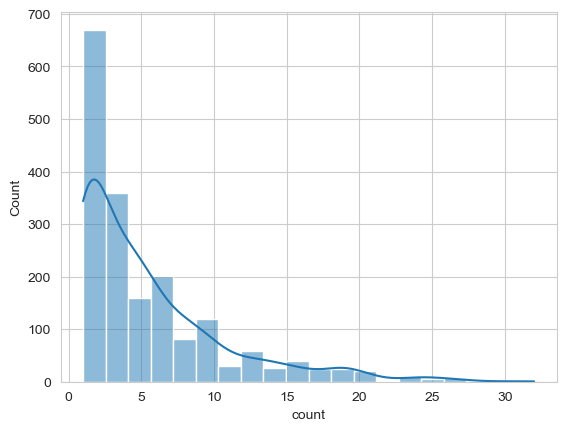

In [29]:
sns.histplot(orders_agg['count'], kde=True, bins=20)

In [30]:
orders_agg['count'].describe(percentiles=[0.25, 0.75, 0.9, 0.95, 0.99])

count    1844.000000
mean        5.488612
std         5.166189
min         1.000000
25%         2.000000
50%         4.000000
75%         7.000000
90%        13.000000
95%        17.000000
99%        24.000000
max        32.000000
Name: count, dtype: float64

Let's now visualize it on a map. Check out [CARTO palettes](https://carto.com/carto-colors/) for making your map more appealing!

In [34]:
Map(Layer(orders_agg, geom_col='geometry', style=color_bins_style('count', breaks=[2, 4, 7, 17], opacity=0.85, palette=palettes.purpor)))

### 2.5. Density patterns using census tracts and the [Modifiable Areal Unit Problem (MAUP)](https://en.wikipedia.org/wiki/Modifiable_areal_unit_problem)

In [35]:
orders.head()

,order_id,lat,lon,geometry,h3
0,0,40.419263,-3.719897,POINT (-3.71990 40.41926),89390cb1a37ffff
1,1,40.417093,-3.713083,POINT (-3.71308 40.41709),89390cb1b53ffff
2,2,40.416763,-3.716036,POINT (-3.71604 40.41676),89390cb1a27ffff
3,3,40.419703,-3.712296,POINT (-3.71230 40.41970),89390cb1bcfffff
4,4,40.419013,-3.719572,POINT (-3.71957 40.41901),89390cb1a37ffff


In [38]:
census.head()

,ccaa,CPRO,CMUN,dist,secc,t1_1,t2_1,t2_2,t3_1,t4_1,t4_2,t4_3,t5_1,t6_1,t7_1,t8_1,t9_1,t10_1,t11_1,t12_1,t13_1,t14_1,t15_1,t16_1,geometry
0,13,28,079,01,001,1159,0.5203,0.4797,47.3106,0.0863,0.6721,0.2416,0.1648,0.2381,0.0482,0.0425,0.6364,0.1129,0.4674,0.5269,0.0113,0.1813,0.2304,0.0585,"POLYGON ((-3.71113 40.42075, -3.7117..."
1,13,28,079,01,002,888,0.5236,0.4764,43.2252,0.0484,0.8018,0.1498,0.2432,0.3660,0.0639,0.0627,0.6071,0.1182,0.5385,0.6107,0.0095,0.1160,0.2166,0.0521,"POLYGON ((-3.71015 40.42294, -3.7103..."
2,13,28,079,01,003,1743,0.4968,0.5032,43.7499,0.0700,0.7631,0.1670,0.2731,0.3798,0.0660,0.0592,0.5663,0.1126,0.5009,0.5645,0.0148,0.1370,0.2332,0.0574,"POLYGON ((-3.70794 40.42153, -3.7077..."
3,13,28,079,01,004,1273,0.5185,0.4815,46.5475,0.0731,0.7023,0.2247,0.1634,0.2577,0.0619,0.0559,0.6424,0.1284,0.4831,0.5542,0.0136,0.1754,0.2042,0.0585,"POLYGON ((-3.71025 40.42079, -3.7102..."
4,13,28,079,01,006,1712,0.4907,0.5093,46.5736,0.0718,0.7214,0.2068,0.1863,0.2769,0.0604,0.0516,0.6834,0.1005,0.5179,0.5758,0.0082,0.1687,0.1951,0.0585,"POLYGON ((-3.70815 40.41906, -3.7081..."


1. Assign every point location to its corresponding census tract through a spatial join.
2. Aggregate counts at the census tract level.

In [44]:
# Steps 1 & 2
ct_mad = census[['ccaa', 'CPRO', 'CMUN', 'dist', 'secc', 'geometry']]

orders_ct = ct_mad.sjoin(orders, how='left').groupby(['ccaa', 'CPRO', 'CMUN', 'dist', 'secc']).agg({'order_id':'count', 'geometry':'first'})\
                .reset_index().rename(columns={'order_id':'count'})

orders_ct.head()

,ccaa,CPRO,CMUN,dist,secc,count,geometry
0,13,28,079,01,001,7,"POLYGON ((-3.71113 40.42075, -3.7117..."
1,13,28,079,01,002,4,"POLYGON ((-3.71015 40.42294, -3.7103..."
2,13,28,079,01,003,6,"POLYGON ((-3.70794 40.42153, -3.7077..."
3,13,28,079,01,004,7,"POLYGON ((-3.71025 40.42079, -3.7102..."
4,13,28,079,01,006,6,"POLYGON ((-3.70815 40.41906, -3.7081..."


Text(0.5, 1.0, 'Census Tract Density Analysis')

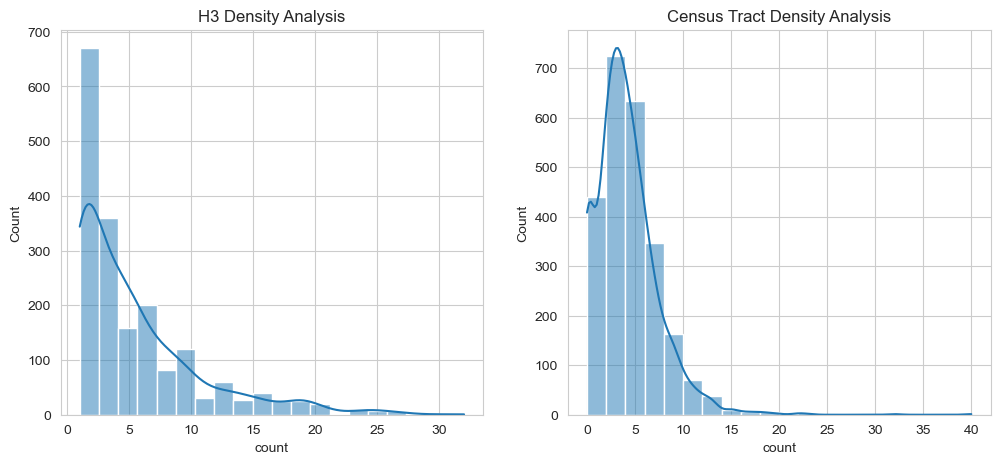

In [49]:
fig, axs = plt.subplots(1, 2, figsize=(12, 5))

sns.histplot(orders_agg['count'], kde=True, bins=20, ax=axs[0])
axs[0].set_title('H3 Density Analysis')
sns.histplot(orders_ct['count'], kde=True, bins=20, ax=axs[1])
axs[1].set_title('Census Tract Density Analysis')

In [60]:
percentiles=[0.25, 0.75, 0.9, 0.95, 0.99]
pd.concat([orders_agg['count'].rename('h3_count').describe(percentiles=percentiles), 
           orders_ct['count'].rename('ct_count').describe(percentiles=percentiles)], axis=1)

,h3_count,ct_count
count,1844.000000,2443.000000
mean,5.488612,4.142857
std,5.166189,3.229493
min,1.000000,0.000000
25%,2.000000,2.000000
50%,4.000000,4.000000
75%,7.000000,6.000000
90%,13.000000,8.000000
95%,17.000000,10.000000
99%,24.000000,14.000000


In [72]:
madrid

,OBJECTID,Shape_Leng,Shape_Area,TM,geometry
0,1,174177.932753,6.044551e+08,Madrid,"POLYGON ((-3.64447 40.63810, -3.6424..."


In [74]:
Layout([Map([Layer(orders_agg, geom_col='geometry', style=color_bins_style('count', breaks=[2, 4, 7, 17], opacity=0.85)),
             Layer(madrid, style=basic_style(opacity=0, stroke_width=2))]),
        Map(Layer(orders_ct, geom_col='geometry', style=color_bins_style('count', breaks=[2, 4, 6, 10], opacity=0.85)))], 
       map_height=750)


How can we normalize?
- By area
- By population
- By POIs

In [68]:
# Normalize by population (x1000 inhabitants)
orders_ct = orders_ct.merge(census[census.columns[:-1]], on=['ccaa', 'CPRO', 'CMUN', 'dist', 'secc'])
orders_ct['count_norm'] = orders_ct['count'] * 1000 / orders_ct['t1_1']
orders_ct.head()

,ccaa,CPRO,CMUN,dist,secc,count,geometry,t1_1,t2_1,t2_2,t3_1,t4_1,t4_2,t4_3,t5_1,t6_1,t7_1,t8_1,t9_1,t10_1,t11_1,t12_1,t13_1,t14_1,t15_1,t16_1,count_norm
0,13,28,079,01,001,7,"POLYGON ((-3.71113 40.42075, -3.7117...",1159,0.5203,0.4797,47.3106,0.0863,0.6721,0.2416,0.1648,0.2381,0.0482,0.0425,0.6364,0.1129,0.4674,0.5269,0.0113,0.1813,0.2304,0.0585,6.039689
1,13,28,079,01,002,4,"POLYGON ((-3.71015 40.42294, -3.7103...",888,0.5236,0.4764,43.2252,0.0484,0.8018,0.1498,0.2432,0.3660,0.0639,0.0627,0.6071,0.1182,0.5385,0.6107,0.0095,0.1160,0.2166,0.0521,4.504505
2,13,28,079,01,003,6,"POLYGON ((-3.70794 40.42153, -3.7077...",1743,0.4968,0.5032,43.7499,0.0700,0.7631,0.1670,0.2731,0.3798,0.0660,0.0592,0.5663,0.1126,0.5009,0.5645,0.0148,0.1370,0.2332,0.0574,3.442341
3,13,28,079,01,004,7,"POLYGON ((-3.71025 40.42079, -3.7102...",1273,0.5185,0.4815,46.5475,0.0731,0.7023,0.2247,0.1634,0.2577,0.0619,0.0559,0.6424,0.1284,0.4831,0.5542,0.0136,0.1754,0.2042,0.0585,5.498822
4,13,28,079,01,006,6,"POLYGON ((-3.70815 40.41906, -3.7081...",1712,0.4907,0.5093,46.5736,0.0718,0.7214,0.2068,0.1863,0.2769,0.0604,0.0516,0.6834,0.1005,0.5179,0.5758,0.0082,0.1687,0.1951,0.0585,3.504673


In [69]:
orders_ct['count_norm'].describe(percentiles=percentiles)

count    2443.000000
mean        3.000397
std         2.001446
min         0.000000
25%         1.670845
50%         2.822865
75%         4.195804
90%         5.526741
95%         6.367808
99%         8.785769
max        14.888337
Name: count_norm, dtype: float64

In [70]:
Layout([Map(Layer(orders_ct, geom_col='geometry', style=color_bins_style('count', breaks=[2, 4, 6, 10], opacity=0.85))),
        Map(Layer(orders_ct, geom_col='geometry', style=color_bins_style('count_norm', breaks=[1.67, 2.82, 4.2, 6.37], opacity=0.85)))], 
       map_height=750)

### 2.6. Global spatial autocorrelation

If we look two maps above, we can see that large parts of Madrid are don't have any h3 cell. This is because no orders were registered there. This makes some spatial analyses challenging. Some alternatives would be:
- Consider missing cells as cells with 0 orders. This would bias the analysis results because zero-value cells will dominate.
- Consider only cells with population (or POIs, buildings or any other relevant variables). We might end up with "islands" and this will also affect our analysis results. In order to get the corresponding population of each cell from the census data, we could use areal interpolation or an interpolation based on another granular variable (e.g., POIs). For for areal interpolation and dasymetric mapping, we can use pysal's [Tobler](https://pysal.org/tobler/).
- Consider all cells within a concave polygon of cells with orders (or any other variable used as criteria).

As a result, for the purpose if this session, we will work with census tracts and normalized orders (#orders / 1000 inhabitants) to overcome this issue.


In [78]:
orders_ct = gpd.GeoDataFrame(orders_ct, crs='epsg:4326')

#### 2.6.1. Spatial weights

“Spatial weights” are one way to represent graphs in geographic data science and spatial statistics. They are widely used constructs that represent geographic relationships between the observational units in a spatially referenced dataset. Implicitly, spatial weights connect objects in a geographic table to one another using the spatial relationships between them. By expressing the notion of geographical proximity or connectedness, spatial weights are the main mechanism through which the spatial relationships in geographical data is brought to bear in the subsequent analysis.

Check out more on spatial weights [here](https://geographicdata.science/book/notebooks/04_spatial_weights.html).

We'll start by using queens weights that considers two polygons to be connected if they share at least one vertex.

In [79]:
wgt_q = weights.Queen.from_dataframe(orders_ct, geom_col='geometry')

In [80]:
wgt_q.histogram

[(1, 1),
 (2, 16),
 (3, 91),
 (4, 295),
 (5, 464),
 (6, 535),
 (7, 420),
 (8, 278),
 (9, 147),
 (10, 75),
 (11, 45),
 (12, 22),
 (13, 12),
 (14, 12),
 (15, 5),
 (16, 6),
 (17, 1),
 (18, 4),
 (19, 2),
 (20, 4),
 (21, 0),
 (22, 1),
 (23, 2),
 (24, 1),
 (25, 1),
 (26, 1),
 (27, 0),
 (28, 1),
 (29, 0),
 (30, 0),
 (31, 0),
 (32, 0),
 (33, 1)]

/Users/malvarez/anaconda3/lib/python3.10/site-packages/splot/_viz_libpysal_mpl.py:115: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  centroids_shp = gdf.centroid.values
/Users/malvarez/anaconda3/lib/python3.10/site-packages/splot/_viz_libpysal_mpl.py:154: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  gdf.centroid.plot(ax=ax, **node_kws)


(<Figure size 1000x1000 with 1 Axes>, <Axes: >)

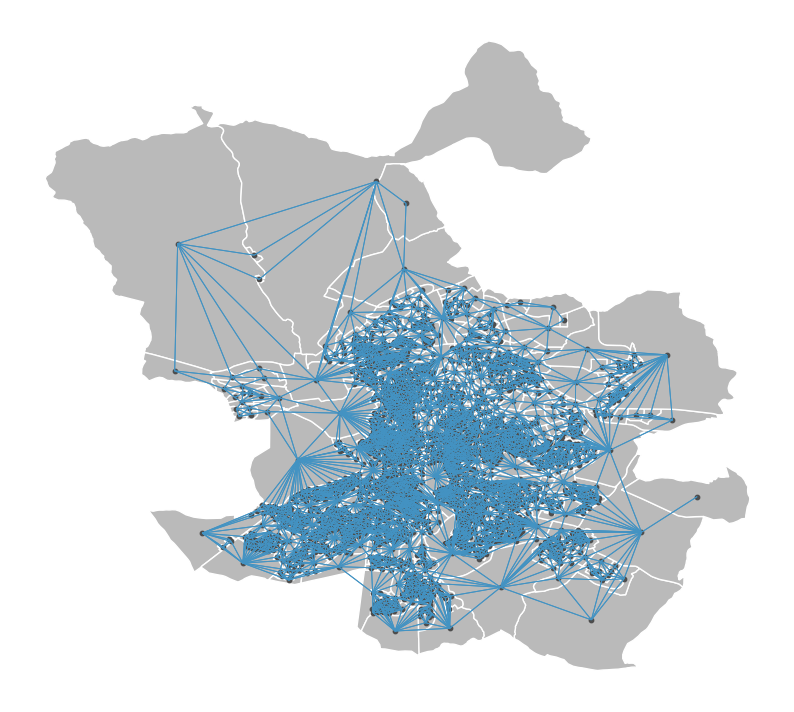

In [172]:
fig, ax = plt.subplots(1, 1, figsize=(10, 10))
plot_spatial_weights(wgt_q, census, ax=ax)

#### 2.6.2. Moran's I

[Tobler's first law of geography](https://en.wikipedia.org/wiki/Tobler%27s_first_law_of_geography#:~:text=The%20First%20Law%20of%20Geography,specifically%20for%20the%20inverse%20distance) states that everything is related to everything else, but near things are more related than distant things.

[Moran's I](https://en.wikipedia.org/wiki/Moran%27s_I) statistic quantifies how much near things are more related than distant things.


<img src="images/morans_i.png" width="850">

In [81]:
mi = esda.moran.Moran(orders_ct['count_norm'], wgt_q)
print("Moran's I: {0:.{1}f}".format(mi.I, 3))
print("Moran's E[I]: {0:.{1}f}".format(mi.EI, 3))
print("Moran's Var[I]: {0:.{1}f}".format(mi.VI_norm, 3))
print("p-value ",mi.p_sim)

Moran's I: 0.510
Moran's E[I]: -0.000
Moran's Var[I]: 0.000
p-value  0.001


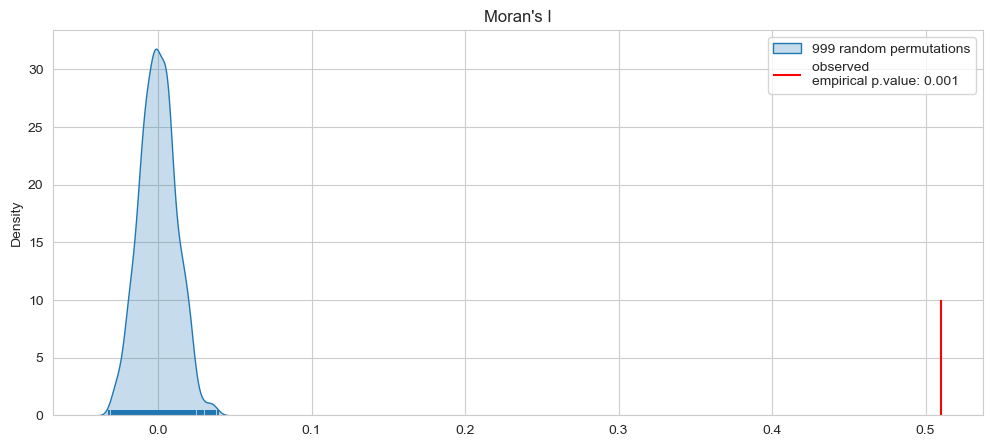

In [82]:
plt.figure(figsize=(12, 5))
sns.kdeplot(mi.sim, fill=True)
plt.vlines(mi.I, 0, 10, 'r')
plt.title("Moran's I")
plt.legend(["999 random permutations", "observed \nempirical p.value: " + str(round(mi.p_sim,3))])
plt.vlines(mi.sim, 0, 0.5)

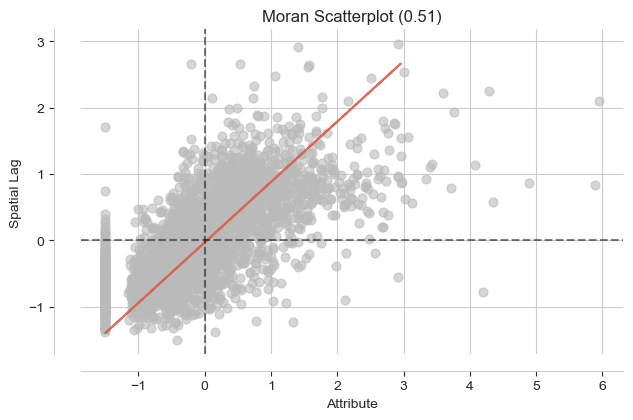

In [83]:
fig, ax = moran_scatterplot(mi, zstandard = True, aspect_equal=True)

### 2.7. Local spatial autocorrelation (Local Moran's I)

Moran’s I does not indicate areas within the map where specific types of values (e.g., high, low) are clustered, or instances of explicit dispersion. In other words, Moran’s I can tell us whether values in our map cluster together (or disperse) overall, but it will not inform us about where specific clusters (or outliers) are.

Local measures of spatial autocorrelation focus on the relationships between each observation and its surroundings, rather than providing a single summary of these relationships across the map. In this sense, they are not summary statistics but scores that allow us to learn more about the spatial structure in our data. 

(<Figure size 1500x700 with 2 Axes>, <Axes: >)

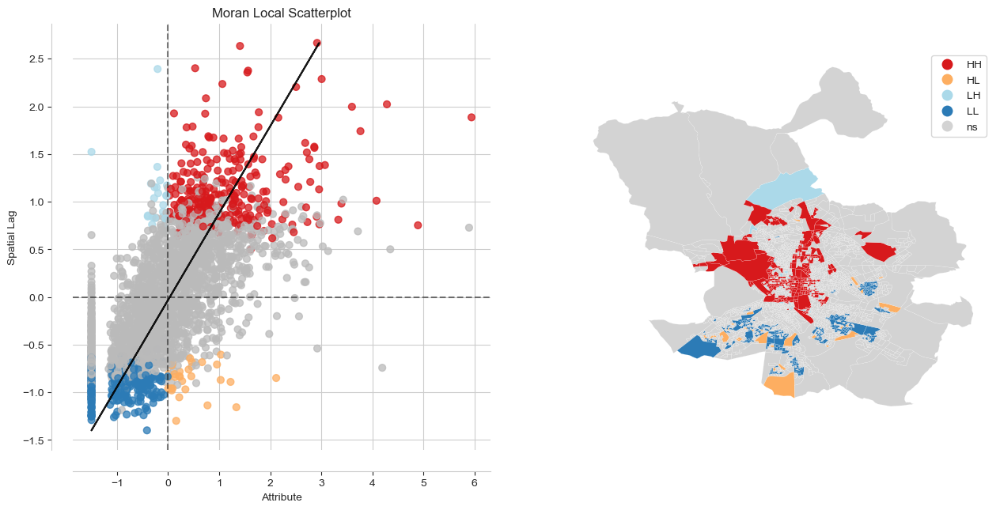

In [86]:
p = 0.01
fig, ax = plt.subplots(1,2, figsize = (15,7))
li = esda.moran.Moran_Local(orders_ct['count_norm'], wgt_q)
moran_scatterplot(li, p=p,  aspect_equal=False, ax = ax[0], scatter_kwds={'alpha':0.75})
lisa_cluster(li, orders_ct, ax = ax[1], p=p)

In [87]:
def assign_cluster(p_value, q, alpha):
    if p_value < alpha:
        if q == 1:
            return 'HH'
        elif q == 2:
            return 'LH'
        elif q == 3:
            return 'LL'
        elif q == 4:
            return 'HL'
    else:
        return 'Not significant'

orders_ct['local_moran_p_value'] = li.p_sim
orders_ct['local_moran_quadrant'] = li.q
orders_ct['cluster'] = orders_ct.apply(lambda row: assign_cluster(row['local_moran_p_value'], row['local_moran_quadrant'], 0.01), axis=1)
orders_ct.head(2)

,ccaa,CPRO,CMUN,dist,secc,count,geometry,t1_1,t2_1,t2_2,t3_1,t4_1,t4_2,t4_3,t5_1,t6_1,t7_1,t8_1,t9_1,t10_1,t11_1,t12_1,t13_1,t14_1,t15_1,t16_1,count_norm,local_moran_p_value,local_moran_quadrant,cluster
0,13,28,079,01,001,7,"POLYGON ((-3.71113 40.42075, -3.7117...",1159,0.5203,0.4797,47.3106,0.0863,0.6721,0.2416,0.1648,0.2381,0.0482,0.0425,0.6364,0.1129,0.4674,0.5269,0.0113,0.1813,0.2304,0.0585,6.039689,0.001,1,HH
1,13,28,079,01,002,4,"POLYGON ((-3.71015 40.42294, -3.7103...",888,0.5236,0.4764,43.2252,0.0484,0.8018,0.1498,0.2432,0.3660,0.0639,0.0627,0.6071,0.1182,0.5385,0.6107,0.0095,0.1160,0.2166,0.0521,4.504505,0.014,1,Not significant


In [ ]:
Map(Layer(orders_ct, style=color_category_style('cluster', 
                                                palette=['#009B9E', '#A7D3D4', '#E4C1D9', '#C75DAB', '#f3f3f3'], 
                                                cat=['LL', 'LH', 'HL', 'HH', 'Not significant'], opacity=0.5)))

In [95]:
census_vars = list(orders_ct.columns[7:-4])

In [100]:
test = orders_ct.groupby('cluster')[census_vars].mean()
test

,t1_1,t2_1,t2_2,t3_1,t4_1,t4_2,t4_3,t5_1,t6_1,t7_1,t8_1,t9_1,t10_1,t11_1,t12_1,t13_1,t14_1,t15_1,t16_1
cluster,,,,,,,,,,,,,,,,,,,
HH,1293.332117,0.544096,0.455904,45.124301,0.122983,0.645419,0.231602,0.119231,0.191222,0.068528,0.063578,0.672389,0.078337,0.505998,0.549289,0.009749,0.185265,0.193384,0.070884
HL,1522.758621,0.532055,0.467945,44.009110,0.142307,0.653776,0.203907,0.146421,0.230941,0.050521,0.036741,0.332234,0.141586,0.487103,0.566176,0.019293,0.167176,0.188710,0.069469
LH,1149.521739,0.544313,0.455687,47.092696,0.098043,0.646109,0.255848,0.127804,0.206230,0.064626,0.059365,0.608365,0.093183,0.488774,0.537674,0.013530,0.210639,0.184904,0.060109
LL,1264.185606,0.531323,0.468677,43.975136,0.134600,0.661249,0.204155,0.209013,0.323607,0.036201,0.024708,0.219683,0.183558,0.443917,0.544141,0.021595,0.156815,0.229413,0.057711
Not significant,1359.273610,0.535038,0.464962,44.588213,0.130156,0.655224,0.214622,0.145588,0.232305,0.054358,0.044557,0.442893,0.125628,0.493508,0.563989,0.014594,0.178564,0.186969,0.065683


**Main conclusions**:
- `t4_1`: Porcentaje de personas menores de 16 años
- `t4_3`: Porcentaje de personas con más de 64 años
- `t5_1`: Porcentaje extranjeros
- `t6_1`: Porcentaje personas nacidas en el extranjero
- `t7_1`: Porcentaje personas cursando estudios superiores (escur =08 09 10 11 12 ) sobre población de 16 y más
- `t8_1`: Porcentaje de personas cursando estudios universitarios (escur = 09 10 11 12 ) sobre población de 16 y más
- `t9_1`: Porcentaje personas con estudios superiores (esreal_cneda=08 09 10 11 12) sobre población de 16 y más
- `t10_1`: Porcentaje de población parada sobre población activa= Parados /Activos
- `t13_1`: Porcentaje de población pensionista por invalidez sobre población de 16 y más=Pensionistas por invalidez / Pob 16 y +
- `t14_1`: Porcentaje de población pensionista por jubilación sobre población de 16 y más=Pensionistas por jubilación / Pob 16 y +

<Axes: ylabel='cluster'>

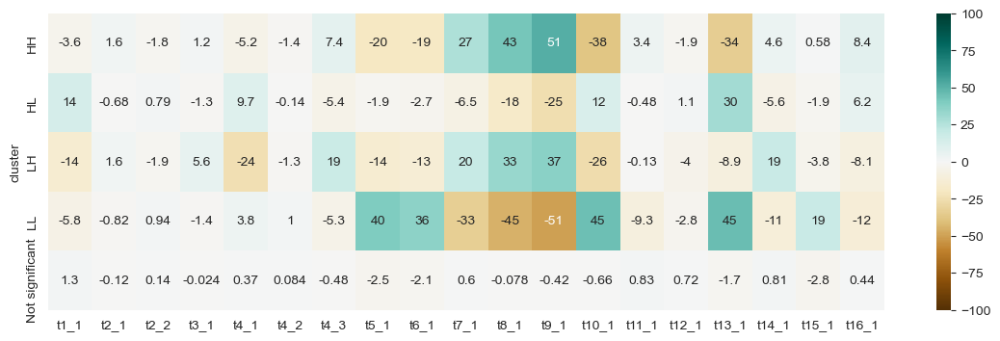

In [109]:
#Heatmap with relative differences with gloabl mean

plt.figure(figsize=(14,4))
sns.heatmap((test - orders_ct[census_vars].mean())*100/orders_ct[census_vars].mean(), vmin=-100, vmax=100, annot=True, cmap='BrBG')

### 2.7. Density-based clustering

**DBSCAN**

In [110]:
orders['x'] = orders.to_crs('epsg:32630').geometry.x
orders['y'] = orders.to_crs('epsg:32630').geometry.y

In [121]:
dbscan = DBSCAN(eps=300, min_samples=50)

In [122]:
dbscan.fit(orders[['x', 'y']])

DBSCAN(eps=300, min_samples=50)

In [123]:
pd.DataFrame(dbscan.labels_).value_counts()

-1     7643
 1      750
 6      607
 0      203
 3      184
 5      174
 10     169
 8      139
 9       88
 7       63
 2       53
 4       48
dtype: int64

In [124]:
orders['cluster'] = list(map(lambda s: f'clust_{s}', dbscan.labels_))
orders.head()

,order_id,lat,lon,geometry,h3,x,y,cluster
0,0,40.419263,-3.719897,POINT (-3.71990 40.41926),89390cb1a37ffff,438926.998160,4.474542e+06,clust_-1
1,1,40.417093,-3.713083,POINT (-3.71308 40.41709),89390cb1b53ffff,439503.197192,4.474296e+06,clust_-1
2,2,40.416763,-3.716036,POINT (-3.71604 40.41676),89390cb1a27ffff,439252.358964,4.474262e+06,clust_-1
3,3,40.419703,-3.712296,POINT (-3.71230 40.41970),89390cb1bcfffff,439572.259430,4.474585e+06,clust_-1
4,4,40.419013,-3.719572,POINT (-3.71957 40.41901),89390cb1a37ffff,438954.369583,4.474514e+06,clust_-1


In [125]:
Map(Layer(orders, style=color_category_style('cluster', opacity=0.5, stroke_width=0, size=3)))

## 3. Undersdtanding spatial drivers for your business performance

We have already identified some of the characteristics of areas of high and low demand through the local autocorrelation analysis. We can now delve into quantifying the impact of various census variables on historical demand. To accomplish this, we will train a simple linear regression model.

Please note that, for the sake of simplicity, we will not conduct a train-test split.

### 3.1. Correlation matrix

We start by taking a look at the correlation matrix.

In [139]:
corr = orders_ct[['count', 'count_norm', 't1_1',
       't2_1', 't2_2', 't3_1', 't4_1', 't4_2', 't4_3', 't5_1', 't6_1', 't7_1',
       't8_1', 't9_1', 't10_1', 't11_1', 't12_1', 't13_1', 't14_1', 't15_1',
       't16_1']].corr()

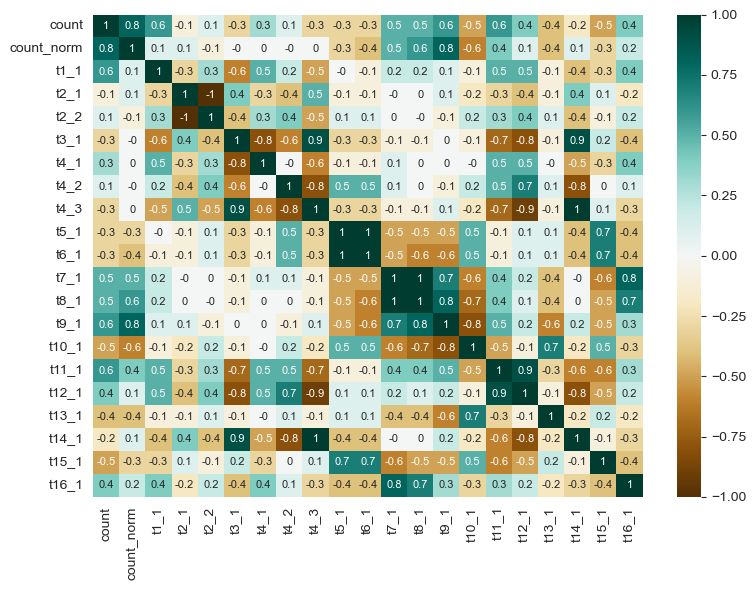

In [138]:
plt.figure(figsize=(8, 6))
sns.heatmap(corr.round(1), 
            xticklabels=corr.columns,
            yticklabels=corr.columns, 
            center = 0, cmap='BrBG', annot=True, annot_kws=dict(fontsize=8))
plt.tight_layout()

### 3.2. Linear regression

In [195]:
predictors = ['t1_1', 't2_1', 't2_2', 't3_1', 't4_1', 't4_2', 't4_3', 't5_1', 't6_1', 't7_1',
              't8_1', 't9_1', 't10_1', 't11_1', 't12_1', 't13_1', 't14_1', 't15_1', 't16_1']

Please note that, for the sake of simplicity, we perform manual feature selection.

In [196]:
#sel_predictors = ['t1_1', 't2_1', 't4_1', 't4_3', 't6_1', 't7_1', 't10_1', 't11_1', 't13_1', 't15_1']
sel_predictors = ['t1_1', 't2_1', 't4_1', 't4_3', 't6_1', 't7_1',
                  't9_1', 't10_1', 't11_1', 't13_1', 't15_1', 't16_1']

In [197]:
lr = LinearRegression()

In [198]:
sc_x = StandardScaler()
X = sc_x.fit_transform(orders_ct[sel_predictors])

sc_y = StandardScaler()
y = sc_y.fit_transform(orders_ct['count_norm'].values.reshape(-1, 1))

In [199]:
lr.fit(X, y)

LinearRegression()

In [200]:
lr.score(X, y)

0.5735968836902001

In [201]:
pd.set_option('display.max_colwidth', 200)
pd.DataFrame(data={'feature': sel_predictors, 'coeff': lr.coef_[0]}).sort_values('coeff', ascending=False)\
    .merge(census_var_df, left_on='feature', right_on='Tabla')

,feature,coeff,Tabla,Indicador
0,t9_1,0.809158,t9_1,Porcentaje personas con estudios superiores (esreal_cneda=08 09 10 11 12) sobre población de 16 y más
1,t15_1,0.143554,t15_1,Porcentaje de población en otra situación de inactividad sobre población de 16 y más=Población en otra situación de inactividad / Pob 16 y +
2,t11_1,0.058540,t11_1,Porcentaje de población ocupada sobre población de 16 y más =Ocupados/ Pob 16 y +
3,t1_1,0.033069,t1_1,Total Personas
4,t16_1,0.028122,t16_1,Porcentaje de población estudiante sobre población de 16 y más=Estudiantes / Pob 16 y +
5,t13_1,0.024030,t13_1,Porcentaje de población pensionista por invalidez sobre población de 16 y más=Pensionistas por invalidez / Pob 16 y +
6,t10_1,0.015371,t10_1,Porcentaje de población parada sobre población activa= Parados /Activos
7,t2_1,0.005304,t2_1,Porcentaje de mujeres
8,t7_1,-0.018069,t7_1,Porcentaje personas cursando estudios superiores (escur =08 09 10 11 12 ) sobre población de 16 y más
9,t6_1,-0.040876,t6_1,Porcentaje personas nacidas en el extranjero


In [202]:
pd.set_option('display.max_colwidth', 40)

#### 3.2.1. Residual analysis

In [203]:
orders_ct['count_pred'] = sc_y.inverse_transform(lr.predict(sc_x.fit_transform(orders_ct[sel_predictors])))
orders_ct['count_pred_error'] = (orders_ct['count'] - orders_ct['count_pred']) / ((orders_ct['count'] + orders_ct['count_pred'])/2)

In [204]:
# Maybe with other weights!

mi = esda.moran.Moran(orders_ct['count_pred_error'], wgt_q)
print("Moran's I: {0:.{1}f}".format(mi.I, 3))
print("Moran's E[I]: {0:.{1}f}".format(mi.EI, 3))
print("Moran's Var[I]: {0:.{1}f}".format(mi.VI_norm, 3))
print("p-value ",mi.p_sim)

Moran's I: 0.127
Moran's E[I]: -0.000
Moran's Var[I]: 0.000
p-value  0.001


In [206]:
orders_ct['count_pred_error'].describe(percentiles=[0.05, 0.25, 0.75, 0.95])

count    2443.000000
mean        0.022326
std         0.859272
min        -2.000000
5%         -2.000000
25%        -0.190177
50%         0.219288
75%         0.586220
95%         1.009151
max         2.021749
Name: count_pred_error, dtype: float64

In [212]:
Map(Layer(orders_ct, style=color_bins_style('count_pred_error', breaks=[-1, -0.5, -0.25, 0, 0.25, 0.5, 1],
                                            palette=palettes.tropic, opacity=0.8)))

### 3.3. Geographically weighted regression

[Geographically weighted regression (GWR)](https://carto.com/blog/how-geographically-weighted-regression-works) quantifies the effect of different predictors on a target variable with geographical weights. GWR performs a local least squares regression for every input cell (polygon) in a continuous grid. Each regression will be calculated based on the data of each cell (polygon) and its user-defined neighborhood. Within that neighborhood, the data of the neighboring cells (polygons) could be assigned a weight dependent on the distance to the origin cell (polygon).

Be careful because this technique is computationally expensive and tends to overfit.

For further detail, check out the following [link](https://mgwr.readthedocs.io/en/latest/).

In [214]:
coords = list(zip(orders_ct.to_crs('epsg:32630').geometry.centroid.apply(lambda p: p.x),
                  orders_ct.to_crs('epsg:32630').geometry.centroid.apply(lambda p: p.y)))

In [215]:
# Fixed= false for KNN
model = GWR(coords, y, X, bw=100, fixed=False, kernel='bisquare')

In [216]:
results = model.fit()

In [217]:
results.R2

0.7746202545741816

#### 3.3.1. Coefficient analysis

In [219]:
pd.DataFrame(results.params, columns=['intercept']+sel_predictors).head()

,intercept,t1_1,t2_1,t4_1,t4_3,t6_1,t7_1,t9_1,t10_1,t11_1,t13_1,t15_1,t16_1
0,-0.923114,-0.493916,0.324043,0.017034,-1.059881,0.231429,0.346439,1.840592,-0.355133,-0.990395,0.313002,-0.345787,-0.724187
1,-1.943158,-0.808517,-0.067596,0.156068,0.117283,0.762261,0.647440,2.515031,-0.201293,-0.438861,0.749499,-0.118892,-0.418349
2,-1.686625,-0.782693,-0.031262,-0.086896,0.004390,0.813199,0.609784,2.108104,-0.387825,-0.849746,0.615788,-0.364547,-0.406278
3,-1.238659,-0.833480,-0.084800,0.052380,-0.110222,0.638375,0.634805,1.890154,-0.500757,-0.966924,0.633841,-0.377406,-0.399932
4,-0.133298,-0.694238,-0.058631,-0.034758,-0.321323,0.407811,0.457101,0.918325,-0.594953,-1.197662,0.329446,-0.475751,-0.198351


In [220]:
pd.DataFrame(results.params, columns=['intercept']+sel_predictors).describe()

,intercept,t1_1,t2_1,t4_1,t4_3,t6_1,t7_1,t9_1,t10_1,t11_1,t13_1,t15_1,t16_1
count,2443.000000,2443.000000,2443.000000,2443.000000,2443.000000,2443.000000,2443.000000,2443.000000,2443.000000,2443.000000,2443.000000,2443.000000,2443.000000
mean,-0.055285,0.047262,-0.013193,-0.045699,-0.007637,-0.044037,-0.066504,0.766486,0.017234,0.089169,-0.003501,0.066570,0.018290
std,0.347272,0.227920,0.166195,0.283593,0.677055,0.338616,0.305747,0.462380,0.542072,0.776018,0.181189,0.383233,0.342566
min,-2.260778,-0.833480,-0.592124,-1.062349,-1.919801,-1.298952,-1.067132,-0.650902,-1.620098,-2.202530,-0.755623,-1.181156,-1.009079
25%,-0.241252,-0.096075,-0.114935,-0.216215,-0.448686,-0.226721,-0.266685,0.444528,-0.319545,-0.420049,-0.095586,-0.156478,-0.210278
50%,-0.052651,0.091435,-0.015189,-0.053274,-0.034414,-0.029093,-0.078320,0.744286,0.019407,0.072705,0.009100,0.078692,0.038051
75%,0.120804,0.229085,0.084764,0.101634,0.417552,0.166639,0.086631,1.055732,0.337771,0.625280,0.090154,0.312789,0.256601
max,1.826551,0.617084,0.815450,2.332933,2.281977,1.196140,1.313862,2.749459,1.583558,2.430509,0.905985,1.259162,0.881871


#### 3.3.2. Coefficient visualization

In [221]:
coeff_df = pd.DataFrame(results.params, columns=['intercept']+sel_predictors)
coeff_df['geometry'] = orders_ct['geometry'].values
coeff_df.head(2)

,intercept,t1_1,t2_1,t4_1,t4_3,t6_1,t7_1,t9_1,t10_1,t11_1,t13_1,t15_1,t16_1,geometry
0,-0.923114,-0.493916,0.324043,0.017034,-1.059881,0.231429,0.346439,1.840592,-0.355133,-0.990395,0.313002,-0.345787,-0.724187,"POLYGON ((-3.71113 40.42075, -3.7117..."
1,-1.943158,-0.808517,-0.067596,0.156068,0.117283,0.762261,0.647440,2.515031,-0.201293,-0.438861,0.749499,-0.118892,-0.418349,"POLYGON ((-3.71015 40.42294, -3.7103..."


In [227]:
# Let's discover different cities!
Map(Layer(coeff_df, geom_col='geometry', style=color_bins_style('t10_1', palette=palettes.earth, opacity=0.8)))

### 3.4. Regression Kriging

GWR is mainly recommended for analysis, but not for modeling. Instead, [Regression Kriging](https://geostat-framework.readthedocs.io/projects/pykrige/en/latest/examples/07_regression_kriging2d.html) is more suitable for modeling. This technique consists of an ensemble of two sequential models:
 1. A regression model to predict the original target variable
 2. Kriging to account for spatial autocorrelation of the residuals of the first model
 
[Pykrige](https://geostat-framework.readthedocs.io/projects/pykrige/en/latest/contents.html) is a Python library that supports 2D and 3D ordinary and universal kriging and has a specific class for regression kriging.

## 4. Territory Creation Techniques

There are different techniques from clustering and optimization for creating territories. The key characteristic is that they normally need to be connected territoies (for every pair of polygons that belong to the same territory, one must be able to travel from one to the other without leaving the territory).

### 4.1. Weights

For territory optimization, we'd like to merge two census tracts only if they share at least one edge. These are called [rook weights](https://geographicdata.science/book/notebooks/04_spatial_weights.html).

In [230]:
wgt_r = weights.Rook.from_dataframe(orders_ct, geom_col='geometry')

In [231]:
wgt_r.histogram

[(1, 1),
 (2, 20),
 (3, 177),
 (4, 656),
 (5, 675),
 (6, 452),
 (7, 222),
 (8, 102),
 (9, 57),
 (10, 21),
 (11, 18),
 (12, 12),
 (13, 4),
 (14, 6),
 (15, 4),
 (16, 2),
 (17, 2),
 (18, 4),
 (19, 1),
 (20, 3),
 (21, 1),
 (22, 0),
 (23, 1),
 (24, 0),
 (25, 1),
 (26, 0),
 (27, 0),
 (28, 1)]

/Users/malvarez/anaconda3/lib/python3.10/site-packages/splot/_viz_libpysal_mpl.py:115: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  centroids_shp = gdf.centroid.values
/Users/malvarez/anaconda3/lib/python3.10/site-packages/splot/_viz_libpysal_mpl.py:154: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  gdf.centroid.plot(ax=ax, **node_kws)


(<Figure size 1000x1000 with 1 Axes>, <Axes: >)

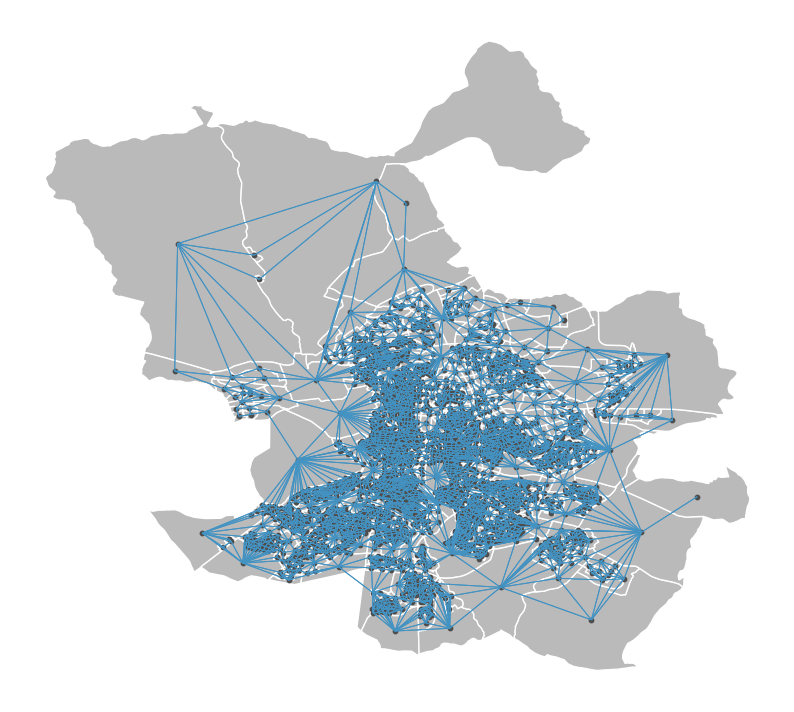

In [233]:
fig, ax = plt.subplots(1, 1, figsize=(10, 10))
plot_spatial_weights(wgt_r, census, ax=ax)

### 4.2. Balanced clusters

When creating territories, the key goal is to get connected areas that balance a specific goal.

### 4.3. Spatially constrained multivariate clustering. Similar and connected clusters

#### 4.3.1. Dimensionality reduction

In [234]:
pca = PCA()

In [235]:
scc = StandardScaler()

In [236]:
pca.fit(scc.fit_transform(orders_ct[['t1_1', 't2_1', 't2_2', 't3_1', 't4_1', 't4_2', 't4_3', 't5_1', 't6_1', 
                   't7_1', 't8_1', 't9_1', 't10_1', 't11_1', 't12_1', 't13_1', 't14_1', 't15_1', 't16_1']]))

PCA()

In [237]:
np.cumsum(pca.explained_variance_ratio_)

array([0.34170604, 0.64068714, 0.73383905, 0.80839394, 0.87192669,
       0.92419906, 0.95312147, 0.9713052 , 0.98269131, 0.99096938,
       0.995506  , 0.99778927, 0.99876123, 0.99935666, 0.99991833,
       0.99997642, 0.99999999, 1.        , 1.        ])

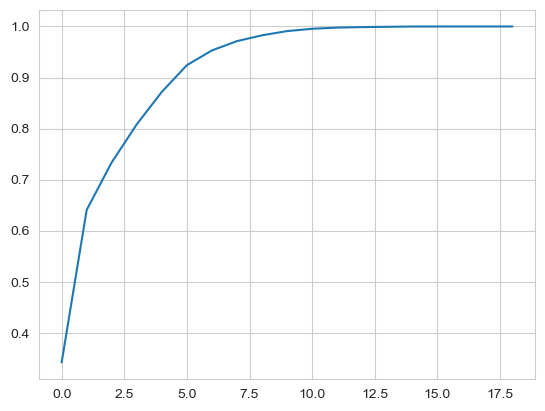

In [238]:
plt.plot(np.cumsum(pca.explained_variance_ratio_))

In [239]:
proj_df = pd.DataFrame((pca.transform(scc.fit_transform(orders_ct[['t1_1', 't2_1', 't2_2', 't3_1', 't4_1', 't4_2', 't4_3', 't5_1', 't6_1', 
                   't7_1', 't8_1', 't9_1', 't10_1', 't11_1', 't12_1', 't13_1', 't14_1', 't15_1', 't16_1']]))[:, :6]),
                   columns=[f'pc_{i+1}' for i in range(6)])

proj_df.head()

,pc_1,pc_2,pc_3,pc_4,pc_5,pc_6
0,0.772471,-0.043249,-0.273175,1.647217,-0.634813,0.260559
1,-1.409795,1.056459,-2.404915,2.728464,-0.084549,-1.221060
2,-1.548268,1.509703,-0.775322,3.221311,-0.222092,0.295571
3,-0.031941,-0.218984,-0.342374,2.010821,-0.294002,-0.421021
4,-1.276347,-0.044381,-0.048812,2.990078,-1.495382,0.265992


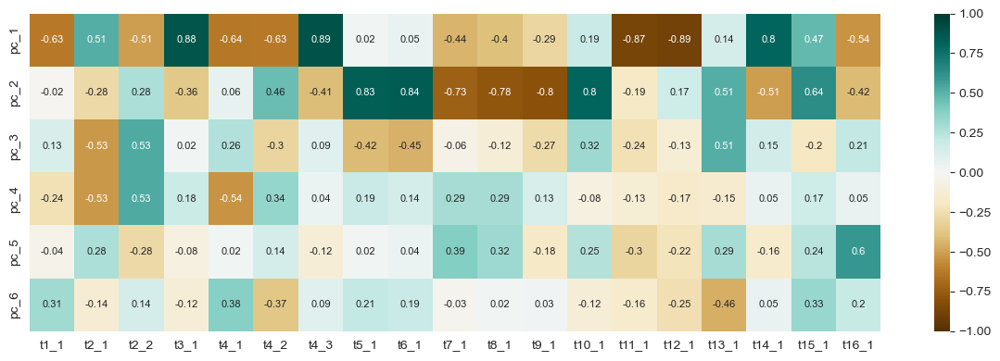

In [245]:
component_rel = pd.concat([proj_df, orders_ct[predictors]], axis=1).corr().loc[[f'pc_{i+1}' for i in range(6)], predictors]

plt.figure(figsize=(12, 4))
sns.heatmap(component_rel.round(2), center=0, cmap='BrBG', annot=True, annot_kws=dict(fontsize=8), 
            vmin=-1, vmax=1, )
plt.tight_layout()

#### 4.3.2. Connectivity constrained agglomerative clustering

Connected clusters that are internally similar.

In [247]:
agg_clust = AgglomerativeClustering(n_clusters=10, connectivity=wgt_r.sparse)

In [248]:
agg_clust.fit(proj_df)

AgglomerativeClustering(connectivity=<2443x2443 sparse matrix of type '<class 'numpy.float64'>'
	with 13228 stored elements in Compressed Sparse Row format>,
                        n_clusters=10)

In [249]:
orders_ct['agg_cluster'] = list(map(lambda v: f'territory_{str.zfill(str(v+1), 2)}', agg_clust.labels_))
orders_ct.head()

,ccaa,CPRO,CMUN,dist,secc,count,geometry,t1_1,t2_1,t2_2,t3_1,t4_1,t4_2,t4_3,t5_1,t6_1,t7_1,t8_1,t9_1,t10_1,t11_1,t12_1,t13_1,t14_1,t15_1,t16_1,count_norm,local_moran_p_value,local_moran_quadrant,cluster,count_pred,count_pred_error,agg_cluster
0,13,28,079,01,001,7,"POLYGON ((-3.71113 40.42075, -3.7117...",1159,0.5203,0.4797,47.3106,0.0863,0.6721,0.2416,0.1648,0.2381,0.0482,0.0425,0.6364,0.1129,0.4674,0.5269,0.0113,0.1813,0.2304,0.0585,6.039689,0.001,1,HH,4.922193,0.348561,territory_05
1,13,28,079,01,002,4,"POLYGON ((-3.71015 40.42294, -3.7103...",888,0.5236,0.4764,43.2252,0.0484,0.8018,0.1498,0.2432,0.3660,0.0639,0.0627,0.6071,0.1182,0.5385,0.6107,0.0095,0.1160,0.2166,0.0521,4.504505,0.014,1,Not significant,4.741100,-0.169567,territory_05
2,13,28,079,01,003,6,"POLYGON ((-3.70794 40.42153, -3.7077...",1743,0.4968,0.5032,43.7499,0.0700,0.7631,0.1670,0.2731,0.3798,0.0660,0.0592,0.5663,0.1126,0.5009,0.5645,0.0148,0.1370,0.2332,0.0574,3.442341,0.124,1,Not significant,4.477576,0.290606,territory_05
3,13,28,079,01,004,7,"POLYGON ((-3.71025 40.42079, -3.7102...",1273,0.5185,0.4815,46.5475,0.0731,0.7023,0.2247,0.1634,0.2577,0.0619,0.0559,0.6424,0.1284,0.4831,0.5542,0.0136,0.1754,0.2042,0.0585,5.498822,0.066,1,Not significant,4.884665,0.355977,territory_05
4,13,28,079,01,006,6,"POLYGON ((-3.70815 40.41906, -3.7081...",1712,0.4907,0.5093,46.5736,0.0718,0.7214,0.2068,0.1863,0.2769,0.0604,0.0516,0.6834,0.1005,0.5179,0.5758,0.0082,0.1687,0.1951,0.0585,3.504673,0.001,1,HH,5.251670,0.133017,territory_05


In [ ]:
np.sort(orders_ct['agg_cluster'].unique())

array(['territory_01', 'territory_02', 'territory_03', 'territory_04',
       'territory_05', 'territory_06', 'territory_07', 'territory_08',
       'territory_09', 'territory_10'], dtype=object)

In [262]:
Map(Layer(orders_ct, 
          style=color_category_style('agg_cluster', cat=list(np.sort(orders_ct['agg_cluster'].unique())), opacity=0.75, palette=palettes.pastel),
          legends=color_category_legend('Cluster')))

In [264]:
orders_ct.groupby('agg_cluster').agg({'t1_1':'sum', 'count':'sum'})

,t1_1,count
agg_cluster,,
territory_01,83885,152
territory_02,1647571,6060
territory_03,213749,762
territory_04,535422,798
territory_05,186563,790
territory_06,189817,350
territory_07,27101,145
territory_08,83544,227
territory_09,109640,512


### 4.4. Spatially constrained multivariate and *balanced* clustering. Similar, *balanced* and connected clusters

In [286]:
proj_df['count'] = orders_ct['count'].values
proj_df['geometry'] = orders_ct['geometry'].values
proj_df = gpd.GeoDataFrame(proj_df, crs='epsg:4326')
proj_df.head()

,pc_1,pc_2,pc_3,pc_4,pc_5,pc_6,count,geometry
0,0.772471,-0.043249,-0.273175,1.647217,-0.634813,0.260559,7,"POLYGON ((-3.71113 40.42075, -3.7117..."
1,-1.409795,1.056459,-2.404915,2.728464,-0.084549,-1.221060,4,"POLYGON ((-3.71015 40.42294, -3.7103..."
2,-1.548268,1.509703,-0.775322,3.221311,-0.222092,0.295571,6,"POLYGON ((-3.70794 40.42153, -3.7077..."
3,-0.031941,-0.218984,-0.342374,2.010821,-0.294002,-0.421021,7,"POLYGON ((-3.71025 40.42079, -3.7102..."
4,-1.276347,-0.044381,-0.048812,2.990078,-1.495382,0.265992,6,"POLYGON ((-3.70815 40.41906, -3.7081..."


#### 4.4.1. Districts 1 and 2

In [287]:
proj_df_f = proj_df.loc[orders_ct[orders_ct['dist'].isin(['01', '02'])].index].copy()
proj_df_f.head()

,pc_1,pc_2,pc_3,pc_4,pc_5,pc_6,count,geometry
0,0.772471,-0.043249,-0.273175,1.647217,-0.634813,0.260559,7,"POLYGON ((-3.71113 40.42075, -3.7117..."
1,-1.409795,1.056459,-2.404915,2.728464,-0.084549,-1.221060,4,"POLYGON ((-3.71015 40.42294, -3.7103..."
2,-1.548268,1.509703,-0.775322,3.221311,-0.222092,0.295571,6,"POLYGON ((-3.70794 40.42153, -3.7077..."
3,-0.031941,-0.218984,-0.342374,2.010821,-0.294002,-0.421021,7,"POLYGON ((-3.71025 40.42079, -3.7102..."
4,-1.276347,-0.044381,-0.048812,2.990078,-1.495382,0.265992,6,"POLYGON ((-3.70815 40.41906, -3.7081..."


In [288]:
wgt_r_f = weights.Rook.from_dataframe(proj_df_f, geom_col='geometry')

In [289]:
orders_ct.loc[orders_ct['dist'].isin(['01', '02']), 'count'].sum()

1115

In [290]:
model = MaxPHeuristic(proj_df_f, 
                      wgt_r_f, 
                      attrs_name = list(proj_df_f.columns[:-1]), 
                      threshold_name = 'count', 
                      threshold = 180,
                      #max_iterations_construction=2,
                      verbose=True)

In [291]:
model.solve()

max_p:  6
number of good partitions: 3
0
totalWithinRegionDistance after SA: 
39432.15310976974
totalWithinRegionDistance after SA: 
39562.85261672795
totalWithinRegionDistance after SA: 
39176.61975391821
totalWithinRegionDistance after SA: 
38519.09809435815
totalWithinRegionDistance after SA: 
39456.54682037602
totalWithinRegionDistance after SA: 
39844.13151982156
totalWithinRegionDistance after SA: 
39688.82759280254
totalWithinRegionDistance after SA: 
39561.01380705357
totalWithinRegionDistance after SA: 
39547.6015198069
totalWithinRegionDistance after SA: 
39413.4941065312
1
totalWithinRegionDistance after SA: 
39005.136627146596
totalWithinRegionDistance after SA: 
38417.06699473827
totalWithinRegionDistance after SA: 
39100.468336740596
totalWithinRegionDistance after SA: 
37571.527667538816
totalWithinRegionDistance after SA: 
38889.07594908074
totalWithinRegionDistance after SA: 
39097.76247166567
totalWithinRegionDistance after SA: 
39862.373612199
totalWithinRegionDistan

In [292]:
proj_df_f['tcluster'] = list(map(lambda v: f'territory_{str.zfill(str(v), 2)}', model.labels_))
proj_df_f.head()

,pc_1,pc_2,pc_3,pc_4,pc_5,pc_6,count,geometry,tcluster
0,0.772471,-0.043249,-0.273175,1.647217,-0.634813,0.260559,7,"POLYGON ((-3.71113 40.42075, -3.7117...",territory_01
1,-1.409795,1.056459,-2.404915,2.728464,-0.084549,-1.221060,4,"POLYGON ((-3.71015 40.42294, -3.7103...",territory_02
2,-1.548268,1.509703,-0.775322,3.221311,-0.222092,0.295571,6,"POLYGON ((-3.70794 40.42153, -3.7077...",territory_02
3,-0.031941,-0.218984,-0.342374,2.010821,-0.294002,-0.421021,7,"POLYGON ((-3.71025 40.42079, -3.7102...",territory_01
4,-1.276347,-0.044381,-0.048812,2.990078,-1.495382,0.265992,6,"POLYGON ((-3.70815 40.41906, -3.7081...",territory_01


In [296]:
Map(Layer(proj_df_f, style=color_category_style('tcluster', opacity=0.75, cat=list(np.sort(proj_df_f['tcluster'].unique())))))

In [294]:
proj_df_f.groupby('tcluster').agg({'count':'sum'})

,count
tcluster,
territory_01,183
territory_02,203
territory_03,181
territory_04,183
territory_05,181
territory_06,184


#### 4.4.2. Madrid city

In [267]:
orders_ct.shape

(2443, 33)

In [272]:
orders_ct['count'].sum()

10121

In [270]:
list(proj_df.columns[:-1])

Index(['pc_1', 'pc_2', 'pc_3', 'pc_4', 'pc_5', 'pc_6'], dtype='object')

In [ ]:
model = MaxPHeuristic(proj_df, 
                      wgt_r, 
                      attrs_name = list(proj_df.columns[:-1]), 
                      threshold_name = 'count', 
                      threshold = 1800, #270, # 180,  #90,
                      #max_iterations_construction=2,
                      verbose=True)

In [ ]:
model.solve()

In [609]:
proj_df['tcluster'] = list(map(lambda v: f'territory_{str.zfill(str(v), 2)}', model.labels_))

In [302]:
proj_df

,pc_1,pc_2,pc_3,pc_4,pc_5,pc_6,count,geometry,tcluster
0,0.772471,-0.043249,-0.273175,1.647217,-0.634813,0.260559,7,"POLYGON ((-3.71113 40.42075, -3.7117...",territory_01
1,-1.409795,1.056459,-2.404915,2.728464,-0.084549,-1.221060,4,"POLYGON ((-3.71015 40.42294, -3.7103...",territory_03
2,-1.548268,1.509703,-0.775322,3.221311,-0.222092,0.295571,6,"POLYGON ((-3.70794 40.42153, -3.7077...",territory_03
3,-0.031941,-0.218984,-0.342374,2.010821,-0.294002,-0.421021,7,"POLYGON ((-3.71025 40.42079, -3.7102...",territory_01
4,-1.276347,-0.044381,-0.048812,2.990078,-1.495382,0.265992,6,"POLYGON ((-3.70815 40.41906, -3.7081...",territory_01
...,...,...,...,...,...,...,...,...,...
2438,-7.536290,-4.076821,0.501029,0.691750,3.329297,1.352755,11,"POLYGON ((-3.60247 40.46952, -3.6021...",territory_05
2439,-3.953604,-0.865706,1.140284,0.392746,0.307258,-0.184434,5,"POLYGON ((-3.58534 40.47107, -3.5853...",territory_05
2440,-7.430602,-0.839031,0.323221,-2.181435,-1.994767,0.474845,15,"POLYGON ((-3.58233 40.47568, -3.5823...",territory_05
2441,-6.612004,-1.539294,1.171943,-0.665494,-1.385332,0.979688,9,"POLYGON ((-3.58872 40.46862, -3.5863...",territory_05


In [306]:
Map(Layer(proj_df, style=color_category_style('tcluster', opacity=0.75, cat=list(np.sort(proj_df['tcluster'].unique())))))

In [305]:
proj_df.groupby('tcluster').agg({'count':'sum'})

,count
tcluster,
territory_01,1801
territory_02,1821
territory_03,1801
territory_04,1946
territory_05,2752


In [307]:
#proj_df.to_csv('data/proj_census_tracts_max_p.csv', index=False)
#proj_df = pd.read_csv('data/proj_census_tracts_max_p.csv')
#proj_df.head()

### 4.5. Two-layer territory management. Balancing workload and maximum distance

See [this use case example](https://carto.com/developers/cartoframes/examples/#example-two-layer-territory-management).